<img src = "https://github.com/exponentialR/DL4CV/blob/main/media/BMC_Summer_Course_Deep_Learning_for_Computer_Vision.jpg?raw=true" alt='BMC Summer Course' width='300'/>

# BMC Summer Course: Deep Learning for Computer Vision
## Walkthrough Excercise on ResNet-18 with Custom Dataset

Author: Samuel A.


## **1. Introduction**

In this exercise, you will use the ResNet-18 model we built from scratch in `2.1` to classify images into three categories: `cats`, `dogs`, and `pandas`. This exercise will help you understand how to implement a deep learning model architecture using a defined architexture, prepare a dataset, train the model, and evaluate its performance.


### **What You Will Learn:**
- Import and Instantiating the ResNet-18 Model.
- Preparing a custom dataset.
- Splitting the dataset into training and validation sets.
- Training the ResNet-18 model.
- Evaluating model performance and visualizing results.
- Using TensorBoard to track metrics during training.

## **2. Setup and Preparation**

### **2.1 Import Libraries**

First, we will import the ResNet18 code from `2.1`. We will also import all the necessary libraries. These include PyTorch for building and training the model, torchvision for handling image datasets, and TensorBoard for visualizing the training process.

In [ ]:
# !pip3 install tensorboard gdown

In [ ]:
import requests

In [ ]:
!curl -O https://github.com/import requests

resnet_url = 'https://github.com/exponentialR/DL4CV/raw/main/resnet18.py'  # Make sure to use the raw link for files
response = requests.get(resnet_url)

with open('resnet18.py', 'wb') as file:
    file.write(response.content)

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  170k    0  170k    0     0   238k      0 --:--:-- --:--:-- --:--:--  238k
curl: (6) Could not resolve host: requests


In [ ]:
# Download the utils code
utils_url = 'https://github.com/exponentialR/DL4CV/raw/main/utils.py'
response = requests.get(utils_url)
with open('utils.py', 'wb') as file:
    file.write(response.content)

In [ ]:
# Import the model architecture
from resnet18 import ResNet18
from utils import list_files
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, random_split
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
import numpy as np
import os
import gdown
import zipfile

### Check Device
We will check if a GPU is available. if not, we will use the CPU.


In [ ]:
# Set device to GPU if available, otherwise use CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f'Using device: {device}')


Using device: cuda


## 3. Data Preparation
### 3.1 Download the Dataset
Let's download the dataset and unzip

In [ ]:
url = 'https://drive.google.com/uc?id=1qw-Vj5IvLIK3Uqzr2if-xSzuzIqEgEuM'
output = 'animals.zip'

gdown.download(url, output, quiet=False)


Downloading...
From (original): https://drive.google.com/uc?id=1qw-Vj5IvLIK3Uqzr2if-xSzuzIqEgEuM
From (redirected): https://drive.google.com/uc?id=1qw-Vj5IvLIK3Uqzr2if-xSzuzIqEgEuM&confirm=t&uuid=8efb436d-e1d0-4290-8500-2284bfeb6ff5
To: /content/animals.zip
100%|██████████| 197M/197M [00:15<00:00, 12.8MB/s]


'animals.zip'

In [ ]:
with zipfile.ZipFile('animals.zip', 'r') as zip_ref:
    zip_ref.extractall('animals')

### 3.2 Dataset Structure
The dataset should be organized into three folders: `cats`, `dogs`, and `pandas`. Each folder contains images corresponding to that category.



In [ ]:

list_files('animals', limit=5)

├── animals/
│   ├── cats/
│   │   ├── cats_00001.jpg
│   │   ├── cats_00002.jpg
│   │   ├── cats_00003.jpg
│   │   ├── cats_00004.jpg
│   │   ├── cats_00005.jpg
│   ├── dogs/
│   │   ├── dogs_00001.jpg
│   │   ├── dogs_00002.jpg
│   │   ├── dogs_00003.jpg
│   │   ├── dogs_00004.jpg
│   │   ├── dogs_00005.jpg
│   ├── panda/
│   │   ├── panda_00001.jpg
│   │   ├── panda_00002.jpg
│   │   ├── panda_00003.jpg
│   │   ├── panda_00004.jpg
│   │   ├── panda_00005.jpg


### 3.3 Define Transformations
We will resize the images to 224x224 pixels (the expected input size for ResNet-18) and normalize them.

In [ ]:
# Define transformations for training and validation datasets
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])


### 3.4 Load and Split the Dataset
We will load the dataset using the ImageFolder class, which automatically assigns labels based on folder names.

In [ ]:
# Load the dataset
data_dir = 'animals/animals'
full_dataset = datasets.ImageFolder(root=data_dir, transform=transform)
class_names = full_dataset.classes
class_to_idx = full_dataset.class_to_idx

print("Class Names:", class_names)
print("Class to Index Mapping:", class_to_idx)

# Split the dataset into training (80%) and validation (20%) sets
train_size = int(0.8 * len(full_dataset))
val_size = len(full_dataset) - train_size
train_dataset, val_dataset = random_split(full_dataset, [train_size, val_size])

# Create DataLoader objects for training and validation sets
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)


Class Names: ['cats', 'dogs', 'panda']
Class to Index Mapping: {'cats': 0, 'dogs': 1, 'panda': 2}


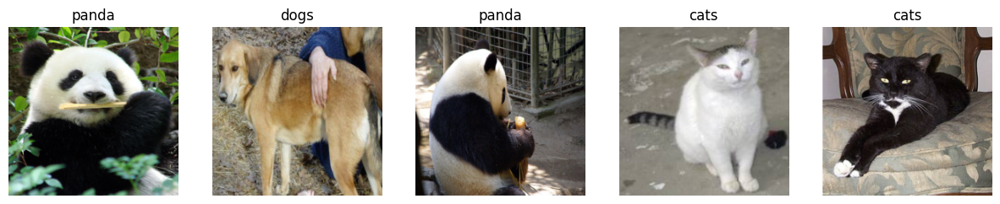

In [ ]:

# Visualize some sample images
dataiter = iter(train_loader)
images, labels = next(dataiter)

fig, axes = plt.subplots(1, 5, figsize=(15, 3))
for i in range(5):
    image = images[i].numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    image = std * image + mean
    image = np.clip(image, 0, 1)
    axes[i].imshow(image)
    axes[i].set_title(class_names[labels[i]])
    axes[i].axis('off')
plt.show()


## Implementing ResNet-18

### 4.1 Instantiate the Model (ResNet-18)

In [ ]:
model = ResNet18().to(device)

### 4.2 Define Loss Function and Optimizer
We will use Cross-Entropy Loss and the Adam optimizer for training the model.

In [ ]:
# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)


## 5. Training the Model
### 5.1 Set Up TensorBoard
We will setup Tensorboard to visualize training metrics like loss and accuracy.

In [ ]:
# Set up TensorBoard
writer = SummaryWriter('runs/ResNet_exercise')

### 5.2 Training Loop
We will train the model for a specified number of epochs, tracking the loss and accuracy. These metrics will be logged to TensorBoard

In [ ]:
num_epochs = 20
for epoch in range(num_epochs):  # Number of epochs
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)  # Move to device

        optimizer.zero_grad()

        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Calculate accuracy
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    epoch_loss = running_loss / len(train_loader)
    epoch_acc = 100 * correct / total

    # Log the metrics to TensorBoard
    writer.add_scalar('Training Loss', epoch_loss, epoch)
    writer.add_scalar('Training Accuracy', epoch_acc, epoch)

    print(f'Epoch {epoch + 1}/{num_epochs}, Loss: {epoch_loss:.4f}, Accuracy: {epoch_acc:.2f}%')


Epoch 1/20, Loss: 0.5899, Accuracy: 71.21%
Epoch 2/20, Loss: 0.5423, Accuracy: 75.04%
Epoch 3/20, Loss: 0.5324, Accuracy: 74.50%
Epoch 4/20, Loss: 0.5082, Accuracy: 76.17%
Epoch 5/20, Loss: 0.4784, Accuracy: 77.46%
Epoch 6/20, Loss: 0.4662, Accuracy: 78.29%
Epoch 7/20, Loss: 0.4706, Accuracy: 78.42%
Epoch 8/20, Loss: 0.4469, Accuracy: 80.17%
Epoch 9/20, Loss: 0.4142, Accuracy: 81.88%
Epoch 10/20, Loss: 0.3481, Accuracy: 85.58%
Epoch 11/20, Loss: 0.3606, Accuracy: 84.42%
Epoch 12/20, Loss: 0.3238, Accuracy: 85.92%
Epoch 13/20, Loss: 0.2967, Accuracy: 87.50%
Epoch 14/20, Loss: 0.2558, Accuracy: 89.25%
Epoch 15/20, Loss: 0.1983, Accuracy: 92.46%
Epoch 16/20, Loss: 0.2105, Accuracy: 91.75%
Epoch 17/20, Loss: 0.1624, Accuracy: 93.38%
Epoch 18/20, Loss: 0.1716, Accuracy: 93.42%
Epoch 19/20, Loss: 0.1186, Accuracy: 95.46%
Epoch 20/20, Loss: 0.1171, Accuracy: 95.46%


## Evaluating the Model
After training, we will evaluate the model on the validation dataset to measure its performance.

In [ ]:
model.eval()
correct = 0
total = 0
with torch.no_grad():
    for inputs, labels in val_loader:
        inputs, labels = inputs.to(device), labels.to(device)  # Move to device
        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

val_acc = 100 * correct / total

# Log the validation accuracy
writer.add_scalar('Validation Accuracy', val_acc, num_epochs)

print(f'Accuracy of the network on the validation images: {val_acc:.2f}%')


Accuracy of the network on the validation images: 79.17%


## 7. Visualizing Results
We will visualize some validation images along with their predicted and actual labels to see how well the model is performing.

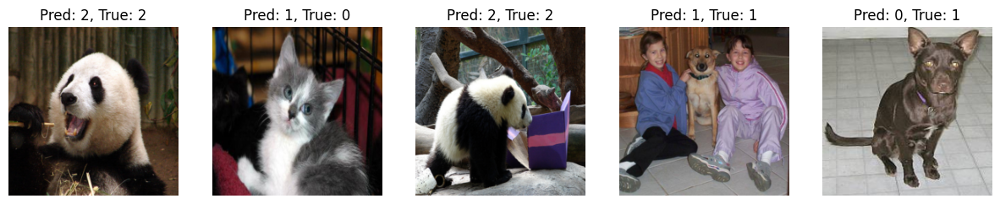

In [ ]:
# Function to visualize some validation images and predictions
def visualize_predictions(model, data_loader):
    model.eval()
    data_iter = iter(data_loader)
    images, labels = next(data_iter)  # Use the built-in next() function
    images, labels = images.to(device), labels.to(device)

    with torch.no_grad():
        outputs = model(images)
        _, preds = torch.max(outputs, 1)

    # Plot some images with their predictions
    fig, axes = plt.subplots(1, 5, figsize=(15, 3))
    for i in range(5):
        axes[i].imshow(np.transpose(images[i].cpu().numpy(), (1, 2, 0)))
        axes[i].set_title(f'Pred: {preds[i].item()}, True: {labels[i].item()}')
        axes[i].axis('off')
    plt.show()

# Visualize the results
visualize_predictions(model, val_loader)


## 8. Saving and Loading the Model
After training, it’s important to save the model so that you can load it later for inference or further training.

In [ ]:
# Save the model
torch.save(model.state_dict(), 'resnet18_cats_dogs_pandas.pth')

# To load the model
# model.load_state_dict(torch.load('resnet18_cats_dogs_pandas.pth'))
# model.eval()


In [ ]:
model_url_id = '1y1enpKZ6AcmP0bWYwsOLwzRIJM_rNts5'

download_url = f'https://drive.google.com/uc?id={model_url_id}'


output = 'resnet_c_d_p.pth'

gdown.download(download_url, output, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1y1enpKZ6AcmP0bWYwsOLwzRIJM_rNts5
From (redirected): https://drive.google.com/uc?id=1y1enpKZ6AcmP0bWYwsOLwzRIJM_rNts5&confirm=t&uuid=8fdb9f6b-58d7-480c-9372-dd39bc4dc6d5
To: /content/resnet_c_d_p.pth
100%|██████████| 44.8M/44.8M [00:02<00:00, 18.0MB/s]


'resnet_c_d_p.pth'

In [ ]:
model.load_state_dict(torch.load('resnet_c_d_p.pth', map_location=device))
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, ke

Download a sample video below to test the model with.

In [ ]:
video_id = '11iWDtEX8svf91K_1aRhUlGMojL_tFZ7q'

download_url = f'https://drive.google.com/uc?id={video_id}'


output = 'walking_dog.mov'

gdown.download(download_url, output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=11iWDtEX8svf91K_1aRhUlGMojL_tFZ7q
To: /content/walking_dog.mov
100%|██████████| 54.4M/54.4M [00:02<00:00, 19.9MB/s]


'walking_dog.mov'

In [ ]:
from PIL import Image
from google.colab.patches import cv2_imshow
import cv2

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

# Define labels (replace with your actual class names)
labels = ['Cat', 'Dog', 'Panda']

# Function to process the video and save the output
def process_video(video_path, output_path):
    cap = cv2.VideoCapture(video_path)
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    out = cv2.VideoWriter(output_path, fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Preprocess the frame
        img = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        img_pil = Image.fromarray(img)
        img_tensor = transform(img_pil).unsqueeze(0).to(device)

        # Get the model prediction
        with torch.no_grad():
            outputs = model(img_tensor)
            _, preds = torch.max(outputs, 1)
            label = labels[preds.item()]

        # Display the label on the frame
        cv2.putText(frame, label, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2, cv2.LINE_AA)

        # Write the frame to the output video
        out.write(frame)

    cap.release()
    out.release()
    cv2.destroyAllWindows()

# Path to the input video file
video_path = 'walking_dog.mov'

# Path to the output video file
output_path = 'processed_walking_dog.mp4'

# Process the video and save the output
process_video(video_path, output_path)

# Display the processed video
from IPython.display import Video
Video(output_path, embed=True)

## 9. Conclusion and Further Work
### 9.1 Summary
In this exercise, we built and trained a ResNet-18 model from scratch to classify images of cats, dogs, and pandas. We went through the entire process from implementing the architecture to data preparation, model training, evaluation, and visualization.

### 9.2 Further Work
- Data Augmentation: Experiment with different data augmentation techniques to improve the model's performance.
- Hyperparameter Tuning: Try different learning rates, batch sizes, and optimizers.